# Foundations - Probability Modeling, Density Estimation, and Instance-Based Learning

## Part A – Probability Modeling with Maximum Likelihood Estimation

The first part of the project focuses on the analysis of the `dataset1.csv` dataset, which consists of 300 samples divided equally into three distinct classes. Each sample is represented by a two-dimensional feature vector, while the third column of the file corresponds to the class label.

A fundamental assumption of this analysis is that the samples of each class are drawn from a different **Multivariate Normal Distribution**, with probability density function:


$$ f({x}) =\frac{1}{\sqrt{(2\pi)^k |\Sigma|}}\exp{(-\frac{1}{2}(\mathbf{x} - \boldsymbol{\mu})^T \Sigma^{-1} (\mathbf{x} - \boldsymbol{\mu}))} $$


The objective is to estimate the parameters of these distributions using **only linear algebra operations**, without relying on high-level statistical
library functions.



In [1]:
import numpy as np
import plotly.graph_objects as go

# Loading and splitting the dataset
dataset = np.loadtxt('dataset1.csv', delimiter=',', skiprows=0) #No header in the ds
labels = [0, 1, 2]
features0 = dataset[0:99, 0:2]
features1 = dataset[99:199, 0:2]
features2 = dataset[199:, 0:2]

# Visualizing the dataset with a 2D scatter-plot
fig2d = go.Figure()

fig2d.add_trace(go.Scatter(
    x=features0[:, 0],
    y=features0[:, 1],
    mode='markers',
    name='Class 0',
    marker=dict(color='red', size=10, opacity=0.4)
))
fig2d.add_trace(go.Scatter(
    x=features1[:, 0],
    y=features1[:, 1],
    mode='markers',
    name='Class 1',
    marker=dict(color='green', size=10, opacity=0.4)
))

fig2d.add_trace(go.Scatter(
    x=features2[:, 0],
    y=features2[:, 1],
    mode='markers',
    name='Class 2',
    marker=dict(color='blue', size=10, opacity=0.4)
))

fig2d.update_layout(
    width=800,
    height=600,
    title="2D Scatter Plot of Dataset Samples",
    xaxis_title="Feature 1",
    yaxis_title="Feature 2",
    legend=dict(x=0.02, y=0.98),
    margin=dict(l=60, r=20, t=60, b=60)
)

fig2d.show()

The above interactive figure visualises the dataset with a two-dimensional scatterplot, where each of the 3 colors represents a different class. Hovering over the scatter points reveals the feature values of that particular sample.

It is obvious that all 3 classes are approximately gaussian, as shown by their elliptical shapes. For each class, most points concentrate around a central mean, and there is a general diagonal tendency relating to the correlation of the features. The dense concentration seen in class 1 suggests higher feature correlation for that class, compared to class 0 where the spreading of the points suggests a weaker correlation.



### Parameter Estimation Methodology
The unknown parameters of the distributions are estimated using the **Maximum Likelihood Estimation (MLE)** framework.

- **Likelihood Function:**
  The log-likelihood function is defined as

  $$ \ell(\theta) = \ln \prod_i p(\mathbf{x}_i \mid \theta) $$


- **Optimization:**
  The optimal parameters are obtained by solving

  $$ \nabla_\theta \ell(\theta) = 0 $$

which leads to closed-form solutions.

- **Mean Estimator:**

$$ \hat{\boldsymbol{\mu}}_{\text{MLE}} = \frac{1}{N} \sum_i \mathbf{x}_i $$


- **Covariance Matrix Estimator:**

$$ \hat{\Sigma}_{\text{MLE}} = \frac{1}{N} \sum_i (\mathbf{x}_i - \boldsymbol{\mu})(\mathbf{x}_i - \boldsymbol{\mu})^T $$

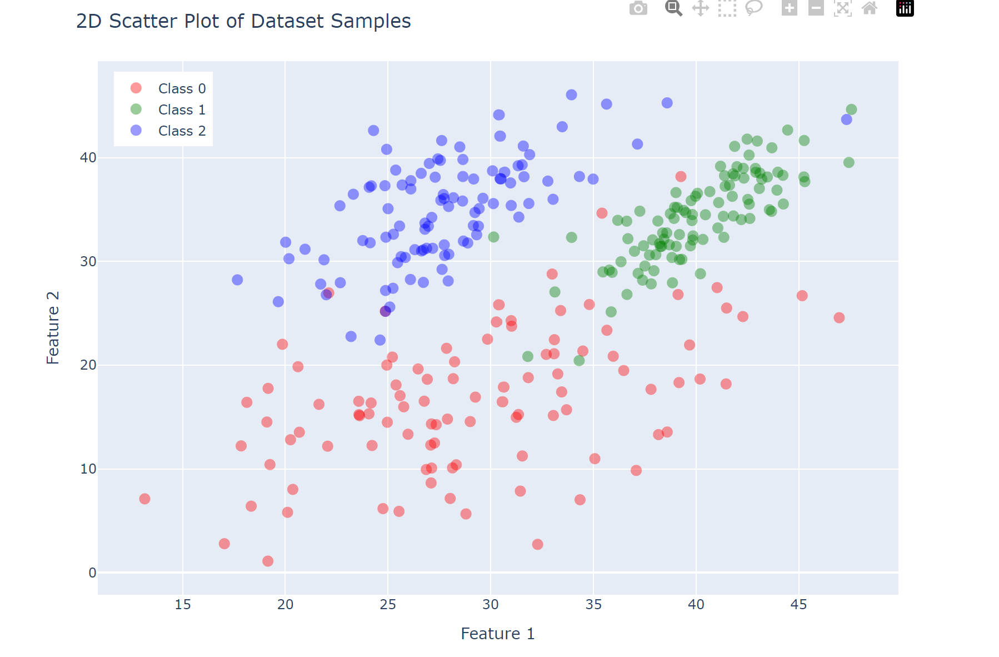

In [2]:
# 2-Variable Gaussian PDF
def gaussian_pdf(x, mean, cov):
    k = len(mean)
    det_cov = np.linalg.det(cov)
    inv_cov = np.linalg.inv(cov)
    xm = x - mean
    exponent = (-1/2)*(xm @ inv_cov @ xm)
    y = np.exp(exponent)/np.sqrt((2*np.pi)**k * det_cov)
    return y

# Close form solution
mean_mle_0 = np.sum(features0, axis=0)/len(features0) #Equivalent to np.mean(features0, axis=0)
mean_mle_1 = np.sum(features1, axis=0)/len(features1) #Equivalent to np.mean(features1, axis=0)
mean_mle_2 = np.sum(features2, axis=0)/len(features2) #Equivalent to np.mean(features2, axis=0)
cov_mle_0 = (features0-mean_mle_0).T@(features0-mean_mle_0)/len(features0)
cov_mle_1 = (features1-mean_mle_1).T@(features1-mean_mle_1)/len(features1)
cov_mle_2 = (features2-mean_mle_2).T@(features2-mean_mle_2)/len(features2)

print("Class 0: ", mean_mle_0)
print(cov_mle_0)
print("Class 1: ", mean_mle_1)
print(cov_mle_1)
print("Class 2: ", mean_mle_2)
print(cov_mle_2)

Class 0:  [29.19947008 16.6932608 ]
[[47.45136322 22.98682938]
 [22.98682938 46.66933573]]
Class 1:  [40.02591366 34.16782734]
[[ 9.89374289 10.99286342]
 [10.99286342 19.24843925]]
Class 2:  [27.74816156 34.88119246]
[[17.66563404 13.38135698]
 [13.38135698 25.81271372]]


In [3]:
# Create the common 3D-plot
x_range = np.arange(0, 50, 0.1)
y_range = np.arange(0, 50, 0.1)
X, Y  = np.meshgrid(x_range, y_range)
Z0 = np.zeros_like(X)
Z1 = np.zeros_like(X)
Z2 = np.zeros_like(X)

fig3d = go.Figure()
for i in range(X.shape[0]):
    for j in range(X.shape[1]):
        point = np.array([X[i, j], Y[i, j]])
        Z0[i, j] = gaussian_pdf(point, mean_mle_0, cov_mle_0)
        Z1[i, j] = gaussian_pdf(point, mean_mle_1, cov_mle_1)
        Z2[i, j] = gaussian_pdf(point, mean_mle_2, cov_mle_2)
fig3d.add_surface(x=X, y=Y, z=Z0, colorscale="Reds", opacity=0.7, name="Class 0", showlegend=True, showscale=False)
fig3d.add_surface(x=X, y=Y, z=Z1, colorscale="Greens", opacity=0.7, name="Class 1", showlegend=True, showscale=False)
fig3d.add_surface(x=X, y=Y, z=Z2, colorscale="Blues", opacity=0.7, name="Class 2", showlegend=True, showscale=False)
fig3d.update_layout(
    width=1000,
    height=600,
    title="3D Common Gaussian Distribution plot",
    xaxis_title="Feature 1",
    yaxis_title="Feature 2",
)

The interactive figure above illustrates the estimated class-conditional distributions in the feature space, where the \(x\) and \(y\) axes correspond to the two feature dimensions, and the \(z\)-axis represents the probability density.

**Class 0**:
- This class is characterized by the mean vector $\mu_0 \approx [29.21, 16.85]^T$, which places its center of gravity in the lower central part of the feature space.
- The most notable element is the covariance matrix $\Sigma_0$, which shows extremely high values on the diagonal ($\sigma_{11}^2 \approx 46.99$ and $\sigma_{22}^2 \approx 48.63$). Scientifically, this indicates a distribution with high generalized variance.
- The probability density curve is extremely flat, suggesting high uncertainty regarding the feature values.
- The positive covariance ($\sigma_{12} \approx 22.91$) indicates a strong positive correlation between the two features, giving the dispersion ellipse a pronounced diagonal orientation.

**Class 1**:
- This class is located in the upper left part of the plane, with the mean vector $\mu_1 \approx [27.55, 34.79]^T$. We observe that it shares a similar level on the y-axis (Feature 2) with Class 2, but is clearly separated along the x-axis.
- The covariance matrix $\Sigma_1$ shows intermediate variance values ($\sigma_{11}^2 \approx 13.97$ and $\sigma_{22}^2 \approx 25.29$). This structure indicates a distribution that is more concentrated than Class 0, yet retains greater variability than Class 2.
- The positive covariance ($\sigma_{12} \approx 11.77$) also confirms a positive linear dependence between the features, although to a lesser degree compared to Class 0.

**Class 2**:
- For this class, the mean estimator is $\mu_2 \approx [40.20, 34.28]^T$, placing the class in the upper right quadrant of the feature space.
- In contrast to Class 0, the covariance matrix $\Sigma_2$ shows significantly lower variance values, particularly along the first axis ($\sigma_{11}^2 \approx 9.42$). This implies that the distribution is narrow along Feature 1, meaning the data are highly concentrated around the mean.
- The distribution is anisotropic, with greater uncertainty along the Feature 2 axis ($\sigma_{22}^2 \approx 20.11$).
- The low determinant of the matrix ($|\Sigma_2|$) indicates that this class is the most compact and well-defined among the three.


## Part B: Density Estimation with Parzen Windows

Part B presents a Parzen Window method implementation for estimating the
probability density function of the sample distribution of `dataset2.csv`, which consists of 200 one-dimensional samples.It is assumed that the data follow a normal distribution with mean $μ = 1$ and standard deviation $σ = 2$,  i.e.

$$p(x) =
\frac{1}{\sigma \sqrt{2\pi}}
e^{-\frac{1}{2}\left(\frac{x-\mu}{\sigma}\right)^2}
=
\frac{1}{2 \sqrt{2\pi}}
e^{-\frac{1}{2}\left(\frac{x-1}{2}\right)^2}
$$

The estimation of the probability density function $\hat{p}(x)$ at a point $x$ using the Parzen window method is given by:

$$\hat{p}(x) =
\frac{1}{N}
\sum_{i=1}^{N}
\frac{1}{h}
K\left(
\frac{x - x_i}{h}
\right)
$$

where:
- $N$: The number of samples
- $h$: The smoothing parameter or window width (bandwidth)
- $K(u)$: The kernel function
- $x_i$: The data points.


In [4]:
from scipy.stats import norm
from plotly.subplots import make_subplots

# Data Loading and Flattening
dataset = np.loadtxt('dataset2.csv', delimiter=',', skiprows=0)
dataset.flatten()

# Visualise data histogram and the true distribution
hist_values, bin_edges = np.histogram(dataset, bins=20, density=True)
fig = go.Figure()
fig.add_trace(go.Bar(
    x=bin_edges[:-1],
    y=hist_values,
    width=np.diff(bin_edges),
    opacity=0.6,
    name='Data Histogram'
))
x_axis = np.linspace(np.min(dataset) - 1, np.max(dataset) + 1, 500)
true_pdf_plot = norm.pdf(x_axis, loc=1, scale=2)
fig.add_trace(go.Scatter(
    x=x_axis,
    y=true_pdf_plot,
    mode='lines',
    line=dict(color='red', width=2),
    name='True Distribution N(1, 4)'
))
fig.update_layout(
    title='Data Histogram vs True Distribution',
    xaxis_title='Value',
    yaxis_title='Probability Density',
    bargap=0.05,
    template='simple_white'
)
fig.show()

By observing the plot produced by the execution of the code,
we conclude the following:
- Histogram Behavior: The histogram of the $N = 200$ samples
follows, with satisfactory accuracy, the shape of the theoretical normal
distribution $\mathcal{N}(1, 4)$.
- Sampling Noise: Local fluctuations are observed
(discontinuities in the height of the bars), which are expected due to the
finite sample size. However, the central tendency around
$μ = 1$ and the dispersion $σ = 2$ are clearly evident.

### Kernels Used

The hypercube kernel is defined as a uniform distribution around zero.
Typically, the width is taken to be 1 (range $[−0.5, 0.5]$):

$$K_H(u) =
\begin{cases}
1 & \text{if } |u| \le \frac{1}{2} \\
0 & \text{otherwise}
\end{cases}$$

The Gaussian kernel is defined as the standard normal distribution:

$$K_G(u) =
\frac{1}{\sqrt{2\pi}}
e^{-\frac{1}{2}u^2}$$

For the evaluation of the method, we compute the Squared Error (SE) for each
data point and sum them to obtain the total error for each value of h:

$$E(h) =
\sum_{j=1}^{N}
\left(
\hat{p}_h(x_j) - p_{\text{real}}(x_j)
\right)^2$$

where $p_{\text{real}}(x_j)$ is the value of the true $\mathcal{N}(1, 4)$ distribution at
point $x_j$.

Considering that the data is assumed to follow a Gaussian distribution, according to the theoretical Silverman’s Rule of Thumb, the approximate optimal value of
$h$ that minimizes the mean integrated squared error is

$$h_{\text{opt}} \approx 1.06 \cdot \hat{\sigma} \cdot N^{-1/5}$$

Substituting the values of the problem ($\sigma = 2, N = 200$):

$$h_{\text{opt}} \approx 1.06 \cdot 2 \cdot (200)^{-0.2}$$

$$h_{\text{opt}} \approx 0.73$$

Therefore, we expect the optimal value of h for the Gaussian kernel to be close to $0.73$.

In [5]:
# Hypercube kernel definition
def hypercube_kernel(u):
    return np.where(np.abs(u) <= 1, 0.5, 0.0)

# Gaussian kernel definition
def gaussian_kernel(u):
    return (1 / np.sqrt(2 * np.pi)) * np.exp(-0.5 * u**2)

# Parzen prediction function
def parzen_predict_point(x, dataset, h, kernel_func):
    n = len(dataset)
    u = (x - dataset) / h
    return np.sum(kernel_func(u)) / (n * h)

# Error calculation across different values of h
h_values = np.arange(0.1, 10.1, 0.1)
true_likelihoods = norm.pdf(dataset, loc=1, scale=2)
errors_hypercube = []
errors_gaussian = []

for h in h_values:
    # Hypercube
    preds_hyp = np.array([parzen_predict_point(xi, dataset, h, hypercube_kernel) for xi in dataset])
    sq_error_hyp = np.sum((preds_hyp - true_likelihoods) ** 2)
    errors_hypercube.append(sq_error_hyp)
    # Gaussian
    preds_gauss = np.array([parzen_predict_point(xi, dataset, h, gaussian_kernel) for xi in dataset])
    sq_error_gauss = np.sum((preds_gauss - true_likelihoods) ** 2)
    errors_gaussian.append(sq_error_gauss)

# Optimal h and min error indexing
min_idx_hyp = np.argmin(errors_hypercube)
min_idx_gauss = np.argmin(errors_gaussian)
best_h_hyp = h_values[min_idx_hyp]
best_h_gauss = h_values[min_idx_gauss]

# Displaying optimal h's and errors
print(f"Hypercube kernel - Optimal h: {best_h_hyp:.1f} - Error: {errors_hypercube[min_idx_hyp]:.4f}")
print(f"Gaussian kernel - Optimal h: {best_h_gauss:.1f} - Error: {errors_gaussian[min_idx_gauss]:.4f}")
silverman_h = 1.06 * 2 * (200 ** (-1/5))
print(f"Silvermann's h for Gaussian kernel: {silverman_h:.4f}\n")

# Create 1×2 subplot layout
fig = make_subplots(rows=1, cols=2, subplot_titles=[
    "Hypercube Kernel Estimation Error",
    "Gaussian Kernel Estimation Error",
])

# Hypercube Kernel Plot
fig.add_trace(
    go.Scatter(
        x=h_values,
        y=errors_hypercube,
        mode='lines+markers',
        line=dict(color='blue'),
        name='Hypercube Error'
    ),
    row=1, col=1
)
fig.add_trace(
    go.Scatter(
        x=[best_h_hyp, best_h_hyp],
        y=[min(errors_hypercube), max(errors_hypercube)],
        mode='lines',
        line=dict(color='grey', dash='dash'),
        name=f'Best h = {best_h_hyp:.1f}'
    ),
    row=1, col=1
)

# Gaussian Kernel Plot
fig.add_trace(
    go.Scatter(
        x=h_values,
        y=errors_gaussian,
        mode='lines+markers',
        line=dict(color='red'),
        name='Gaussian Error'
    ),
    row=1, col=2
)
fig.add_trace(
    go.Scatter(
        x=[best_h_gauss, best_h_gauss],
        y=[min(errors_gaussian), max(errors_gaussian)],
        mode='lines',
        line=dict(color='grey', dash='dash'),
        name=f'Best h = {best_h_gauss:.1f}'
    ),
    row=1, col=2
)

# Layout settings
fig.update_xaxes(title_text="Bandwidth h", row=1, col=1)
fig.update_yaxes(title_text="Sum of Squared Errors", row=1, col=1)
fig.update_xaxes(title_text="Bandwidth h", row=1, col=2)
fig.update_yaxes(title_text="Sum of Squared Errors", row=1, col=2)
fig.update_layout(
    width=1000,
    height=500,
    showlegend=True,
    template="simple_white",
    title_text="Kernel Estimation Error Comparison"
)
fig.show()


Hypercube kernel - Optimal h: 1.4 - Error: 0.2145
Gaussian kernel - Optimal h: 0.8 - Error: 0.2233
Silvermann's h for Gaussian kernel: 0.7347



**Gaussian Kernel:**

The experimental results confirm the theoretical analysis regarding the selection of the optimal window width $h$.
- Theoretical Value (Silverman): $h_{\text{opt}} \approx 0.7347$
- Experimental Value: $h_{\text{exp}} = 0.8$

The experimental value lies extremely close to the theoretical prediction. The small deviation ($\Delta h \approx 0.065$) is due to the randomness of sampling. The fact that $h_{\text{exp}} \approx h_{\text{opt}}$ indicates that the Parzen method, when using a Gaussian kernel on data drawn from a normal distribution, converges rapidly to the optimal solution.

**Hypercube kernel**:

- Experimental Value: $h_{\text{exp}} = 1.4$

The optimal $h$ for the hypercube is significantly larger than that of the Gaussian kernel ($1.4 > 0.8$). This occurs because
the hypercube is a discontinuous kernel.  In order to achieve a smooth approximation of the curved Gaussian distribution and to reduce the effect of the abrupt “steps” it creates, a larger smoothing width is required. In contrast, the Gaussian kernel,
being inherently smooth, requires a smaller $h$ to adapt to the data without losing detail.

**Squared Errors (SE)**:

The total squared errors that were computed are:
$$
E_{\text{Hypercube}} \approx 0.2145 \quad \text{and} \quad
E_{\text{Gaussian}} \approx 0.2233
\tag{7}
$$

Although the Gaussian kernel is theoretically more suitable for estimating a normal distribution (due to its smoothness), the errors are comparable. In this particular implementation, the hypercube achieved a slightly smaller total error. In general, both kernels, when tuned with the appropriate $h$ (which was calculated experimentally), can provide a satisfactory estimation of the probability density function. In both error plots, we observe the characteristic curve to have a **convex** shape.

**Bias–Variance Tradeoff**:

The behavior of Parzen windows constitutes a classic illustration of the Bias–Variance Tradeoff:
- In the left part of the plots ($h \to 0$), the error is high and decreases sharply. The Parzen window is very narrow, resulting in an estimate filled with spikes over the data. This is the phenomenon of **high variance**, where the model “memorizes” the distribution along with the noise, instead of learning it.
- In the right part of the plots ($h > 4$), the error increases gradually, almost linearly. This is happening because the window is excessively wide, causing the estimate to fall flat and lose the peak of the distribution. This is the phenomenon of **high bias**

In [6]:
# Distribution Visualization
x_grid = np.linspace(np.min(dataset) - 2, np.max(dataset) + 2, 1000)

# True PDF
true_pdf_grid = norm.pdf(x_grid, loc=1, scale=2)

# Parzen Windows Estimation for hypercube kernel
est_pdf_hyp = np.array([parzen_predict_point(x, dataset, best_h_hyp, hypercube_kernel) for x in x_grid])

# Parzen Windows Estimation for gaussian kernel
est_pdf_gauss = np.array([parzen_predict_point(x, dataset, best_h_gauss, gaussian_kernel) for x in x_grid])

# Create subplot layout (1 row, 2 columns)
fig = make_subplots(
    rows=1, cols=2,
    subplot_titles=[
        "Optimal Estimation with Hypercube Kernel",
        "Optimal Estimation with Gaussian Kernel"
    ]
)
# Histogram data (shared)
hist_vals, hist_bins = np.histogram(dataset, bins=20, density=True)
bin_centers = (hist_bins[:-1] + hist_bins[1:]) / 2

# Hypercube Kernel Plot
fig.add_trace(
    go.Bar(
        x=bin_centers,
        y=hist_vals,
        width=np.diff(hist_bins),
        marker_color='skyblue',
        opacity=0.3,
        name='Data Histogram',
        showlegend=True
    ),
    row=1, col=1
)
fig.add_trace(
    go.Scatter(
        x=x_grid,
        y=true_pdf_grid,
        mode='lines',
        line=dict(color='grey', dash='dash', width=2),
        name='True PDF'
    ),
    row=1, col=1
)
fig.add_trace(
    go.Scatter(
        x=x_grid,
        y=est_pdf_hyp,
        mode='lines',
        line=dict(color='blue', width=2),
        name=f'Est (Hypercube), h={best_h_hyp:.2f}'
    ),
    row=1, col=1
)

# Gaussian Kernel Plot
fig.add_trace(
    go.Bar(
        x=bin_centers,
        y=hist_vals,
        width=np.diff(hist_bins),
        marker_color='skyblue',
        opacity=0.3,
        name='Data Histogram',
        showlegend=False  # avoid duplicate legend entries
    ),
    row=1, col=2
)
fig.add_trace(
    go.Scatter(
        x=x_grid,
        y=true_pdf_grid,
        mode='lines',
        line=dict(color='grey', dash='dash', width=2),
        name='True PDF',
        showlegend=False
    ),
    row=1, col=2
)
fig.add_trace(
    go.Scatter(
        x=x_grid,
        y=est_pdf_gauss,
        mode='lines',
        line=dict(color='red', width=2),
        name=f'Est (Gaussian), h={best_h_gauss:.2f}'
    ),
    row=1, col=2
)
fig.update_layout(
    width=1100,
    height=500,
    template='simple_white',
    title_text="Parzen Window Density Estimation Comparison"
)

fig.update_xaxes(title_text="x", row=1, col=1)
fig.update_yaxes(title_text="Density", row=1, col=1)
fig.update_xaxes(title_text="x", row=1, col=2)
fig.update_yaxes(title_text="Density", row=1, col=2)
fig.show()

The inflection point and the minimum error differ depending on the kernel:
- Gaussian: $h_{\text{opt}} = 0.8$
- Hypercube: $h_{\text{opt}} = 1.4$

Observation: The hypercube requires a larger smoothing width in order to
compensate for the discontinuity of its shape.

The comparison of the optimal curves overlaid on the histogram highlights the importance of kernel selection.

**Hypercube Kernel**:
- The hypercube requires a larger smoothing width in order to compensate for the discontinuity of its shape.
- The shape of the curve is step-like. That is because the hypercube kernel is a "box", a discontinuous functions. The sum of
discontinuous functions inevitably produces discontinuities—step-like shapes.
- Consequently, although $h = 1.4$ is optimal, the approximation remains artificial and rough.

**Gaussian Kernel**:
- Contrary to the case of the hypercube kernel, the curve is perfectly smooth and continuous because the kernel is the normal distribution, a function differentiable to any order.
- Therefore, the estimate smoothly approximates the true distribution
$\mathcal{N}(1, 4)$. A smaller $h$ ($0.8$) is required because the kernel naturally matches the data.


## Part C: Instance-Based Learning with k-Nearest Neighbors from scratch

The k Nearest Neighbors (kNN) algorithm is a machine learning algorithm, more specifically a supervised learning classifier. It operates by selecting the k nearest neighbors, namely the training data, and classifies a new test data point based on their majority vote. The
K-Nearest Neighbors algorithm is also referred to as a lazy learner because it does not learn immediately from the training set; instead, it stores the entire dataset and performs computations only at the time of classification.

The two hyperparameters of this classifier are the number k of neighbors considered during classification and the type of distance used between them: Euclidean, Manhattan, and Mahalanobis.

In this part, the above classifier is implemented from scratch for binary classification and is “trained” using the `dataset3.csv` dataset in order to classify the data of the `testset.csv` dataset.


In [7]:
# Data Loading
train_data = np.loadtxt('dataset3.csv', delimiter=',', skiprows=0)
test_data = np.loadtxt('testset.csv', delimiter=',', skiprows=0)
all_data = np.vstack((train_data, test_data))


X = all_data[:, 0:2]     # Features
y = all_data[:, -1].astype(int)  # Labels

labels = np.unique(y)
colors = ['red', 'blue']

# Histograms
fig = make_subplots(
    rows=1, cols=2,
    subplot_titles=("Feature 1", "Feature 2")
)
for lbl, color in zip(labels, colors):
    class_data = X[y == lbl]
    # Feature 1
    fig.add_trace(
        go.Histogram(
            x=class_data[:, 0],
            histnorm='probability density',
            name=f'Class {lbl}',
            marker_color=color,
            opacity=0.6
        ),
        row=1, col=1
    )
    # Feature 2
    fig.add_trace(
        go.Histogram(
            x=class_data[:, 1],
            histnorm='probability density',
            marker_color=color,
            opacity=0.6,
            showlegend=False
        ),
        row=1, col=2
    )
fig.update_layout(
    title="Histograms of Feature Distributions",
    barmode='overlay',
    width=1000,
    height=500,
    template='plotly_white',
    legend_title_text='Class'
)
fig.show()

# Scatter plots
fig = make_subplots(
    rows=1, cols=2,
    column_widths=[0.5, 0.5],
    subplot_titles=("Feature 1", "Feature 2"),
    horizontal_spacing=0.05,
    vertical_spacing=0.05
)
for lbl, color in zip(labels, colors):
    class_data = X[y == lbl]
    # Feature 1
    fig.add_trace(
        go.Scatter(
            x=class_data[:, 0],
            y=class_data[:, 1],
            mode='markers',
            name=f'Class {lbl}',
            marker=dict(color=color, size=6, opacity=0.7)
        ),
        row=1, col=1
    )
    # Feature 2
    fig.add_trace(
        go.Scatter(
            x=class_data[:, 0],
            y=class_data[:, 1],
            mode='markers',
            name=f'Class {lbl}',
            marker=dict(color=color, size=6, opacity=0.7),
            showlegend=False
        ),
        row=1, col=2
    )
fig.update_layout(
    title="Scatter Plots of Feature Distributions",
    width=1000,
    height=500,
    barmode='overlay',
    template='plotly_white',
)
fig.show()

The above figure presents the distribution analysis of the two features of
the merged dataset3.csv and testset.csv datasets, separated based on their
class labels Label 0 and Label 1. The main purpose of these plots is to examine
whether the features can distinguish Class 0 from Class 1.

**Feature 1**:

- There is a clear differentiation in the
behavior of the two classes in terms of their central tendency and variability.
- Class 1 appears shifted to the left, with its distribution peaking at lower
values (approximately 9–10) and exhibiting large dispersion (a wide curve),
covering a broad range of values from 4 to 22.
- In contrast, Class 0 is shifted
to the right, with a mean value close to 14–15 and smaller dispersion, being
more concentrated around its mean. This implies that Feature 1 is a strong
indicator for extreme values: observations with values below 8 almost certainly
belong to Class 1, while values above 18 indicate Class 0 with high probability.
- The main challenge for the classifier lies in the overlap zone between 10 and
15, where the probabilities of the two classes are comparable.

**Feature 2**:

- The distinguishing difference is observed not
only in the location but also in the shape of the distributions.
- Class 1 is characterized by an extremely sharp and narrow distribution, with the vast
majority of the data concentrated around the value 28–29, indicating high
consistency in the characteristics of this group.
- On the other hand, Class 0 exhibits a much smoother and more spread-out distribution, i.e., a larger
standard deviation with a center of gravity around 35. Here, the discriminative
power of the feature is strong near the peaks (a sample with value 28 is very
likely to be blue, while one with value 38 is likely red); however, the “tail”
of the red distribution penetrates deeply into the region of the blue one
(range 25–32), creating a significant area of uncertainty where the k-NN
algorithm will rely solely on the majority of neighbors to make a decision.


In [8]:
fig = go.Figure()

labels = np.unique(train_data[:, -1]).astype(int)
class_colors = {0: 'red', 1: 'blue'}

for lbl in labels:
    class_train = train_data[train_data[:, -1] == lbl]
    class_test = test_data[test_data[:, -1] == lbl]
    fig.add_trace(go.Scatter(
        x=class_train[:, 0],
        y=class_train[:, 1],
        mode='markers',
        name=f'Train Class {lbl}',
        marker=dict(
            color=class_colors[lbl],
            size=13,
            opacity=0.6
        )
    ))
    fig.add_trace(go.Scatter(
        x=class_test[:, 0],
        y=class_test[:, 1],
        mode='markers',
        name=f'Test Class {lbl}',
        marker=dict(
            color=class_colors[lbl],
            symbol='star',
            size=18,
            line=dict(color='black', width=1.2)
        )
    ))
fig.update_layout(
    title="Feature Ovelap: Train vs Test",
    xaxis_title="Feature 1",
    yaxis_title="Feature 2",
    width=900,
    height=700,
    template="plotly_white",
    showlegend=True,
    legend=dict(
        x=0.02,
        y=0.98,
        bgcolor="rgba(255,255,255,0.8)"
    )
)
fig.show()

The above diagram illustrates the joint distribution of the training and test samples for both classes in the two-dimensional feature space.
- There is a substantial region where Class 0 and Class 1 samples overlap, particularly in the central area of the plot, indicating that the classes are not linearly separable based on these features alone. Both training and test points follow similar spatial patterns, suggesting that the test set is representative of the training distribution and that no major dataset shift is present.
- However, the dense intermixing of points from different classes implies that local neighborhoods often contain samples from both labels. As a result, a kNN classifier operating in these regions may face ambiguity, with its predictions being highly sensitive to the choice of $k$ and the local sample composition.
- In overlapping zones, small values of $k$ may lead to high variance and unstable predictions, while larger values of $k$ may oversmooth the decision boundary and introduce bias. Overall, the observed feature overlap is expected to limit the maximum achievable classification accuracy and makes careful hyperparameter tuning crucial for robust kNN performance.

### Auxiliary Functions:

**Function eucl()**:

The function eucl computes the Euclidean distance between a given input point
$x$ and all samples contained in the training set trainData. Initially, it
separates the features from the training data by keeping all columns except
the last one (which typically contains the class labels). Then, using
vectorized operations for efficiency, it computes the difference between $x$
and each row of the feature matrix, squares these differences, sums them
row-wise (axis=1), and takes the square root of the result. Finally, it returns
an array (dists) containing the distance of point $x$ from each individual
sample in trainData.

**Function neighbors()**:

The function neighbors is responsible for identifying and returning the
$k$ nearest neighbors of point $x$ from the training set trainData.
Initially, it calls the eucl function to compute the distances between $x$
and all available samples. It then uses the `np.argsort` command to find the
indices that would sort these distances in ascending order (from smallest to
largest) and selects only the first $k$ of them (top-$k$ indices), which
correspond to the closest points. Finally, it uses these indices to retrieve
and return the corresponding rows from trainData—entire samples including
their features and class labels—that constitute the $k$ nearest neighbors.

**Function predict()**:

The function predict performs the prediction process for an entire test
dataset (testData) using the logic of the k-NN algorithm. For each sample in
testData, it identifies the $k$ nearest neighbors from the training set by
calling the neighbors function and then isolates the labels (classes) of these
neighbors. Subsequently, it counts how many of the neighbors belong to Class 0
and how many belong to Class 1 and converts these counts into probabilities by
dividing the number of occurrences of each class by the total $k$. Finally,
it aggregates and returns an array containing the pairs of probabilities for
each point in testData.

In [9]:
# Functions

def eucl(x, train_data):
    features = train_data[:, :-1]
    # Vectorized distance calculation: sqrt(sum((x-y)^2))
    diff = features - x
    dists = np.sqrt(np.sum(diff**2, axis=1))
    return dists

def neighbors(x, train_data, k):
    # Distance Calculation
    dists = eucl(x, train_data)
    # Classification
    sorted_indices = np.argsort(dists)
    top_k_indices = sorted_indices[:k]
    return train_data[top_k_indices]

def predict(test_data, train_data, k):
    probabilities = []
    for row in test_data:
        x = row[:-1] # Features
        # K nearest Neighbors
        k_nn = neighbors(x, train_data, k)
        # Labels in the last columnt
        neighbor_labels = k_nn[:, -1]
        # Prob calculation
        count_0 = np.sum(neighbor_labels == 0)
        count_1 = np.sum(neighbor_labels == 1)
        prob_0 = count_0 / k
        prob_1 = count_1 / k
        probabilities.append([prob_0, prob_1])
    return np.array(probabilities)

# Optimal K with Cross Validation in the test set
print("\nCalculating accuracy for k = 1 to 30...")

accuracies = []
k_range = range(1, 31)
labels = test_data[:, -1]

for k in k_range:
    # Probabilities
    probs = predict(test_data, train_data, k)
    # if prob_1 > prob_0 then we classify as 1 else 0
    # index of max prob
    predictions = np.argmax(probs, axis=1)
    # Accuracy calculation
    accuracy = np.mean(predictions == labels)
    accuracies.append(accuracy)

# Plot the k exploration
fig = go.Figure()
fig.add_trace(go.Scatter(
    x=tuple(k_range),
    y=accuracies,
    mode='lines+markers',
    marker=dict(size=8),
    line=dict(width=2),
    name='Accuracy'
))
fig.update_layout(
    title='Classifier Accuracy for Different k Values',
    xaxis_title='k Value',
    yaxis_title='Accuracy',
    width=900,
    height=500,
    template='plotly_white'
)
fig.update_xaxes(tickmode='array', tickvals=tuple(k_range))
fig.show()

# Extract optimal K
best_accuracy = max(accuracies)
best_k = k_range[accuracies.index(best_accuracy)] # more than 1 k's gives the same accuracy ? choose the smallest value
print(f"Optimal k: {best_k}")
print(f"Accuracy: {best_accuracy:.2f} ({best_accuracy*100}%)")


Calculating accuracy for k = 1 to 30...


Optimal k: 11
Accuracy: 0.74 (74.0%)


The accuracy of the k Nearest Neighbors classifier on the
validation dataset (test set) is studied for a number of neighboring points $k$ in the
range $[1, 30]$. From the implementation of the above analysis, it is obvious
that the accuracy of the k-NN classifier exhibits an interesting behavior that
can be divided into four zones depending on the range to which $k$ belongs:

- **Instability and Overfitting for $k$ in the range $[1, 10]$**: At the initial
stage, where $k$ takes small values, we observe strong instability and low
overall performance. Starting from $k = 1$, the accuracy is very low, only
54%. Although there is a temporary increase at $k = 6$ (reaching
approximately 66%), it is followed by a sharp and abrupt drop at $k = 7$,
where the accuracy collapses again to 54%. This “sawtooth” behavior is a
classic example of **Overfitting**.
When $k$ is so small, the algorithm is excessively sensitive to noise and
individual points (outliers). The class decision for a point is based on very
few neighbors, so if even a single neighbor is incorrect (i.e., noise is
introduced), the prediction fails.


- **The Optimal Balance Region for $k$ in the range $[11, 15]$**: This is the
most critical region of the diagram, as this is where maximum performance is
achieved. At $k = 11$, the curve reaches its highest point with an accuracy of
74%. Immediately afterward, for $k = 13$ and $k = 15$, the accuracy remains
extremely high, reaching approximately 72%. In this range, the algorithm has
achieved the optimal balance between bias and variance. The value of $k$ is
large enough to suppress noise (through the voting of many neighbors), while
at the same time small enough to respect the local boundaries between classes.
The model is more reliable.


- **Stability and Plateau for $k$ in the range $[16, 23]$**: As we move to
intermediate values of $k$, we observe a phase of stabilization. From
$k = 18$ up to $k = 23$, the accuracy “locks” at a specific level, fluctuating
slightly around 68% to 70%. Here, the classifier’s decision boundary begins to
become smoother. Although the performance is acceptable, it is clearly lower
than the peak at $k = 11$. This indicates that increasing the number of
neighbors beyond a certain point does not provide additional information, but
instead gradually “blurs” the details that separated the classes in the optimal
region.


- **Underfitting and Decline for $k$ in the range $[24, 30]$**: In the final stage
of the diagram, performance begins to decline noticeably. After $k = 24$, we
observe a downward trend with new fluctuations, reaching a local minimum at
$k = 28$ with an accuracy of only 60%. This is the phenomenon of **Underfitting**. The neighborhood window has now become
too large. The algorithm takes into account points that are far away from the
point of interest, which may belong to the opposing class but dominate due to
population majority in the wider area. The model has become overly simplistic
and loses its ability to distinguish the classes accurately.

In [10]:
# Plot the decision boundary for k=11
print(f"\nDrawing decision boundaries for k={best_k}...")
x_min, x_max = train_data[:, 0].min() - 1, train_data[:, 0].max() + 1
y_min, y_max = train_data[:, 1].min() - 1, train_data[:, 1].max() + 1
h = 0.1
xx, yy = np.meshgrid(np.arange(x_min, x_max, h),
                     np.arange(y_min, y_max, h))
grid_points = np.c_[xx.ravel(), yy.ravel()]
grid_input = np.hstack((grid_points, np.zeros((grid_points.shape[0], 1))))
# Prediction
probs_grid = predict(grid_input, train_data, best_k)
Z = np.argmax(probs_grid, axis=1)
Z = Z.reshape(xx.shape)

fig = go.Figure()
# Add decision boundary using heatmap
fig.add_trace(go.Heatmap(
    x=np.arange(x_min, x_max, h),
    y=np.arange(y_min, y_max, h),
    z=Z,
    colorscale=colors,
    opacity=0.3,
    showscale=False
))
# Add training points
fig.add_trace(go.Scatter(
    x=train_data[:, 0],
    y=train_data[:, 1],
    mode='markers',
    marker=dict(
        color=train_data[:, -1],
        colorscale=colors,
        line=dict(color='black', width=1),
        size=12
    )
))
fig.update_layout(
    title=f'KNN Decision Boundaries (k={best_k})',
    xaxis_title='Feature 1',
    yaxis_title='Feature 2',
    template='plotly_white',
    width=1000,
    height=750,
)
fig.show()



Drawing decision boundaries for k=11...


### Decision boundary for $k=11$

The visualization shows the decision boundaries of the k‑NN classifier for the optimal value $k=11$, projecting the data into the 2‑dimensional space of the two features.

The plane is divided into two zones:
- Light‑blue region → the model predicts Class 0
- Red region → the model predicts Class 1

The boundary separating the two regions is not a simple straight line. It forms an irregular, nonlinear shape that weaves between the data points in an attempt to separate the two classes. The algorithm correctly identifies the main clusters:
- Red points tend to appear bottom‑left
- Blue points tend to appear top‑right

However, there are “islands” and indentations in the central area (Feature 1: 12–18, Feature 2: 30–35) where the classes are mixed.

- The presence of red points “trapped” inside the blue region (and vice versa) visually confirms classification errors caused by the overlap of feature distributions discussed earlier.
- Points of one class appearing inside the decision region of the other (e.g., red circles inside blue areas near the center) provide visual evidence of the Bayes error.
- Due to the inherent overlap of the two feature distributions (as seen in the histograms), no deterministic boundary can perfectly separate the classes.
- These points represent the misclassified samples in the training set, where the classes overlap.

The k‑NN classifier with  $k=11$ effectively ignores these isolated points to achieve better generalization, avoiding overfitting that would otherwise create overly complex boundaries around each individual point.